In [2]:
import pickle
import numpy as np
from multiprocessing import Pool

import requests, json
import pandas as pd
import glob
import time
from multiprocessing import Pool
import numpy as np
from scipy import stats

def toc(start_time):
    elapsed = timeit.default_timer() - start_time
    print(elapsed)
    
# from zipfile import ZipFile
import re
# from pprint import pprint
# import glob
import pickle

import matplotlib as mpl
import seaborn as sns
import matplotlib.cm as cm
import pickle
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import matplotlib.transforms as mtransforms
sns.set_theme(style='white')

%matplotlib inline
%config InlineBackend.figure_format = 'svg'

plt.rcParams['xtick.major.size'] = 3
plt.rcParams['xtick.major.width'] = 1
plt.rcParams['xtick.bottom'] = True
plt.rcParams['ytick.left'] = True
sns.set_context('talk', font_scale=.65)
mpl.rcParams.update({'text.usetex': False})

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

In [3]:
import pandas as pd
df_submissions=pd.read_csv('submissions_reddit.csv')
df_comments=pd.read_csv('comments_reddit.csv')

In [4]:
# df_submissions.sort_values(['created_utc'],ascending=False)
df_submissions['created_utc_'] = pd.to_datetime(df_submissions['created_utc'], unit='s')


In [5]:
len(df_submissions['subreddit'].unique())
# number of unique subreddits

11165

In [6]:
len(df_comments['subreddit'].unique())


3794

## Filtering subreddits on relevance and activity 

In [7]:
irrelevant_items = ["meatcanyon", "happymeatfarms", "themeatz","mytimeatportia","thighmeat", "datbootymeat", "videomeat", "u_meatierman", "chavmeat2", "gameattack", "freshmeattv","00darkmeatbuffet","satxmeatmarket", "jackmeatsflix","mytimeatsandrock","joinmeatthecampfire","u_meatsandwit","supermeatboy","meatosubincision","rollerderby_freshmeat","meatslap", "labiadarkmeat","uncutmanmeat","shittyveganfoodporn","water_on_the_meat_sex","beatthemeat", "fuckmeat","chavmeat","cumeatingcuckolds","deadmeatjames","cumeatinginstructions","meatyvaginas","cumeatinginstruction","hangnmeat","u_jigglybootymeat","sweatermeat","u_blaqmeat","beatmeattoit",    "u_confident_climate_11",    "fuckmeat2",    "u_meaty-midgets",    "u_slutmeatcunt",    "africanbootymeat",    "meatyflesh",    "u_unfairmeat71266",    "u_unfairmeat7126",    "jigglybootymeat",    "meatlessmealprep",    "meatwalls",    "gradeafuckmeat",    "smalldelimeats",    "meatcrayon",    "femdomcumeatingh",    "thatveganteachersucks",    "veganforbeginners",    "meatloaf",    "redmeatscience",    "censored_meat",    "beatmymeattoit",    "rapemeat",    "vegan_fashionadvice",    "rmeatwife",    "forcedcumeating",    "fuckmeat_sluts",    "meatporn",    "meatheads",    "meatygirls",    "rubmymeatandsmokeme",    "u_meatgodnc336",    "u_meatgodofficial",    "bumbblondefuckmeat"];



df_submissions['filter']= (df_submissions['subreddit'].isin(irrelevant_items))| (df_submissions['subreddit'].str.contains('puss')) | (df_submissions['subreddit'].str.contains('onlyfans')) | (df_submissions['subreddit'].str.contains('cumeat')) | (df_submissions['subreddit'].str.contains('sweatermeat')) 
df_submissions_filtered=df_submissions[df_submissions['filter']==False]

min_posts_threshold = 500 # Anything that occurs less than this will be removed.
value_counts = df_submissions_filtered['subreddit'].value_counts() # Entire DataFrame 
dict_subreddit_to_numposts={}
for x in zip(value_counts.index,value_counts):
    dict_subreddit_to_numposts[x[0]]=x[1]   
df_submissions_filtered['num_posts_on_subreddit']=df_submissions_filtered['subreddit'].map(dict_subreddit_to_numposts);
df_submissions_filtered=df_submissions_filtered[df_submissions_filtered['num_posts_on_subreddit']>=min_posts_threshold]

#(df_submissions['num_comments']<1) & & (df_submissions['subreddit_subscribers']>100) this removes the subreddits which have nan as subscribers

C:\Users\Chowdhary\AppData\Local\Temp\5\ipykernel_4944\3733916304.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_submissions_filtered['num_posts_on_subreddit']=df_submissions_filtered['subreddit'].map(dict_subreddit_to_numposts);


In [8]:
top_subreddits=df_submissions_filtered.groupby(by='subreddit')['num_posts_on_subreddit'].mean().sort_values(ascending=False)
top100subreddits=top_subreddits[0:100].index

In [9]:
 np.where(top100subreddits=='debateavegan')

(array([17], dtype=int64),)

In [10]:
top100subreddits

Index(['vegan', 'climatechaos', 'vegancirclejerk', 'climate', 'vegetarian',
       'climateskeptics', 'veganrecipes', 'veganfoodporn', 'veganfitness',
       'climatedisalarm', 'climatechange', 'antivegan', 'meat', 'vegan_food',
       'vegande', 'veganuk', 'climateactionplan', 'debateavegan',
       'climatejobslist', 'climateoffensive', 'veganforcirclejerkers',
       'vegetarianism', 'veganfood', 'simplyvegan', 'veganity', 'highvegans',
       'exvegans', 'glutenfreevegan', 'veganfoodie', 'vegan1200isplenty',
       'vegansgonewild', 'veganbaking', 'veganlobby', 'vegetarianrecipes',
       'veganactivism', 'veganchill', 'veganbeauty', 'vegetarianketo',
       'eatcheapandvegan', 'vegetarianfoodporn', 'climatesplattergate',
       'climatememes', 'globalclimatechange', 'veganism', 'veganarchism',
       'u_conscious-climate-80', 'climate_news', 'veganketo', 'askvegans',
       'climate_science', 'veganlobbyde', 'veganmemes', 'climatecrisiscanada',
       'smokingmeat', 'meatrabbitry'

### filter comments to these subreddits

In [11]:
# dict_subreddit_in_top100={}
# for x in top100subreddits:
#     dict_subreddit_in_top100[x]=True  
    
commentintop100subreddit=[x in top100subreddits for x in list(df_comments['subreddit'])]
df_comments['commentintop100subreddit']=commentintop100subreddit
df_comments_filtered=df_comments[df_comments['commentintop100subreddit']==True]
# link_id is id of parent submission

In [12]:
import numpy as np
round(100*np.sum((commentintop100subreddit))/len(commentintop100subreddit),1)

90.8

### cross-posts

In [45]:
round(100*df_submissions_filtered[df_submissions_filtered['num_crossposts']>0].shape[0]/df_submissions_filtered.shape[0],1)

2.1

Only 2% of Submissions are posted across subreddits.

In [44]:
round(100*df_submissions_filtered[df_submissions_filtered['num_crossposts']>1].shape[0]/df_submissions_filtered.shape[0],1)

0.5

### users number of comments in a subreddit

In [89]:
# df_comments_filtered

In [51]:
num_comments_per_user=df_comments_filtered.groupby('author').count()

In [80]:
# num_comments_per_user=df_comments_filtered.groupby('author')['subreddit'].apply(list).count()
num_subreddits_per_user=df_comments_filtered.groupby('author')['subreddit'].nunique()

In [54]:
# user_spread_across_100_subreddits=list(X['subreddit'])

In [68]:
import collections

c = collections.Counter(num_subreddits_per_user)
c=c.most_common(len(c))

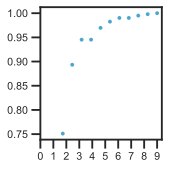

In [88]:
label_ff = 20;ff = 20;aa=14;bb=6;wspace_=.8;hspace_=.5;
fig = plt.figure(figsize=(aa, bb));
falph=.35
spec = gridspec.GridSpec(ncols=4, nrows=2,width_ratios=[1,1,1,1], wspace=wspace_,hspace=hspace_, height_ratios=[1,1])
custom_palette = ["#b3e2cd", "#fdcdac", "#cbd5e8",  "#f1e2cc","#e6f5c9", "#fff2ae", "#f4cae4",]
sns.set_style("ticks")
taxX=-.45
#____________________________________________
ax = fig.add_subplot(spec[0]);

def plotCDF(ax,data,label,nbin,color,showpdf=False):
    al=.9
    count, bins_count = np.histogram(data, bins=nbin)
    # finding the PDF of the histogram using count values
    pdf = count / sum(count)
    # using numpy np.cumsum to calculate the CDF
    # We can also find using the PDF values by looping and adding
    cdf = np.cumsum(pdf)
    # plotting PDF and CDF
    if showpdf==True:
        plt.plot(bins_count[1:], pdf, label=label+' pdf',alpha=al,color=color)
    ax.scatter(bins_count[1:], cdf,s=6, label=label,alpha=al,color=color);

nbin=11
num_subreddits_per_user=np.array(num_subreddits_per_user)
X=num_subreddits_per_user[num_subreddits_per_user<10]
colors=['#43a2ca','#a8ddb5']
plotCDF(ax,X,'data',nbin,colors[0]);
ax.set_xticks([x for x in range(0,10)]);

## climate subreddit only

### Topics model

In [13]:
df_sub_climate=df_submissions_filtered[df_submissions_filtered['subreddit']=='climate']
df_com_climate=df_comments_filtered[df_comments_filtered['subreddit']=='climate']

In [12]:
df_com_climate.groupby(by='author').count()

,body,subreddit,created_utc,controversiality,score,link_id,parent_id,commentintop100subreddit
author,,,,,,,,
------why------,1,1,1,1,1,1,1,1
---sanguine---,1,1,1,1,1,1,1,1
--_-_o_-_--,138,138,138,138,138,138,138,138
--aldo--,2,2,2,2,2,2,2,2
--harumph--,6,6,6,6,6,6,6,6
...,...,...,...,...,...,...,...,...
zzmeesheezz,1,1,1,1,1,1,1,1
zzsaltycrackerzz,1,1,1,1,1,1,1,1
zzz_ch,2,2,2,2,2,2,2,2


In [13]:
# # Choose an embedding backend
# !pip install bertopic[flair, gensim, spacy, use]

# # Topic modeling with images
# !pip install bertopic[vision]

In [14]:
from bertopic import BERTopic
df_sub_climate['selftext']=df_sub_climate['selftext'].astype(str)
np.mean(df_sub_climate['selftext']!='nan')
### time it 

0.12712640520182247

In [15]:

topic_model = BERTopic()
topics, probs = topic_model.fit_transform(df_sub_climate['title'])
freq = topic_model.get_topic_info()


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [89]:
### time it 
# topic_model = BERTopic()


In [90]:
freq.head(20)

,Topic,Count,Name,Representation,Representative_Docs
0,-1,32897,-1_energy_emissions_coal_and,"[energy, emissions, coal, and, of, to, the, ga...",[Water stored on land stopped recent sea level...
1,0,702,0_warmest_hottest_month_record,"[warmest, hottest, month, record, consecutive,...",[July 2016 Was Earth's Warmest Month on Record...
2,1,639,1_arctic_ice_sea_extent,"[arctic, ice, sea, extent, low, lowest, volume...","[Arctic Sea Ice: What, Why, and What Next, Thi..."
3,2,619,2_solar_panels_rooftop_farm,"[solar, panels, rooftop, farm, power, cells, p...",[We can officially collect solar energy withou...
4,3,544,3_trump_trumps_donald_president,"[trump, trumps, donald, president, administrat...",[What President Donald Trump could mean for th...
5,4,540,4_cop27_cop26_summit_cop24,"[cop27, cop26, summit, cop24, egypt, cop25, co...","[Cop26, COP26: Climate Change, How likely is p..."
6,5,528,5_exxon_exxonmobil_mobil_exxons,"[exxon, exxonmobil, mobil, exxons, knew, fraud...",[Inside an investigation into Exxon Mobil's cl...
7,6,523,6_trees_tree_planting_forests,"[trees, tree, planting, forests, forest, plant...","[Why not just plant more trees?, Planting Tree..."
8,7,510,7_co2_ppm_dioxide_atmospheric,"[co2, ppm, dioxide, atmospheric, 400, concentr...",[Is Our Number Up - What Does CO2 at 400 ppm M...
9,8,488,8_farmers_agriculture_wheat_crop,"[farmers, agriculture, wheat, crop, farming, c...","[Climate change and agriculture, Farmers fail ..."


In [91]:
# topic_model.get_document_info(titles)

### climate subreddit social network

In [16]:
# df_com_climate['created_utc_'] = pd.to_datetime(df_com_climate['created_utc'], unit='s')
df_topics=topic_model.get_document_info(df_sub_climate['title'])
df_topics
df_sub_climate['topic']=df_topics['Topic']
df_sub_climate['topic_name']=df_topics['Name']
df_sub_climate['probability']=df_topics['Probability']
df_sub_climate=df_sub_climate.sort_values(by=['topic','created_utc_'])
df_sub_climate_w_topics=df_sub_climate[['author', 'title', 
       'num_comments', 'num_crossposts', 'score', 'id',
        'upvote_ratio', 'created_utc_',
        'topic', 'topic_name', 'probability']]
df_sub_climate_w_topics=df_sub_climate_w_topics[df_sub_climate_w_topics['topic']!=-1]
df_sub_climate_w_topics=df_sub_climate_w_topics[df_sub_climate_w_topics['topic'].astype(str)!='nan']
X=df_sub_climate_w_topics.groupby(by='topic_name')['num_comments'].count()
dict_topic_size={x:y for x,y in zip(X.index,list(X))}
df_sub_climate_w_topics['topic_size']=df_sub_climate_w_topics['topic_name'].map(dict_topic_size)
post_threhold=10
df_sub_climate_w_topics_atleast10posts=df_sub_climate_w_topics[df_sub_climate_w_topics['topic_size']>post_threhold]


In [17]:
df_sub_climate_w_topics_atleast10posts.head(3)

,author,title,num_comments,num_crossposts,score,id,upvote_ratio,created_utc_,topic,topic_name,probability,topic_size
1155,silence7,Using short-term weather data doesn't tell you...,1,0.0,8,7gywr,NaN,2008-12-02 22:08:36,0.0,0_solar_panels_rooftop_power,1.0,64
720,gst,A Cautionary Tale About Models Of Complex Systems,0,0.0,0,80ux4,NaN,2009-02-27 20:30:59,0.0,0_solar_panels_rooftop_power,1.0,64
228,pandemik,The ocean ain't flat: sea level is anomalously...,0,0.0,10,aae2l,NaN,2009-12-02 19:49:45,0.0,0_solar_panels_rooftop_power,1.0,64


In [131]:
## topic with n posts : quest level 3 : make survival plot by num posts?

In [276]:
X=df_sub_climate_w_topics_atleast10posts.groupby(by='topic_name')['num_comments'].count()
np.sum(np.array(list(X))>10)

147

10

9.0

## attention received by topics

In [133]:
df_sub_climate_w_topics_atleast10posts[df_sub_climate_w_topics_atleast10posts['num_comments']>0].groupby(by='topic_name')['num_comments'].mean()


topic_name
0_warmest_hottest_month_record              2.074074
100_flying_flight_aviation_travel           3.200000
101_extinction_mass_sixth_extinctions       5.750000
102_18nine_g6_lg_peculiar                   2.200000
103_snow_snowfall_winter_snowing            1.000000
                                              ...   
95_economic_economics_economy_economists    1.500000
96_forests_forest_tropical_trees            1.600000
97_coal_plant_coalfired_coals               2.000000
99_skeptics_skeptic_sceptic_arguments       6.428571
9_amazon_rainforest_brazil_brazils          4.157895
Name: num_comments, Length: 147, dtype: float64

In [134]:
df_sub_climate_w_topics_atleast10posts.groupby(by='topic_name')['num_comments'].mean()


topic_name
0_warmest_hottest_month_record              0.658824
100_flying_flight_aviation_travel           1.600000
101_extinction_mass_sixth_extinctions       1.437500
102_18nine_g6_lg_peculiar                   1.222222
103_snow_snowfall_winter_snowing            0.466667
                                              ...   
95_economic_economics_economy_economists    0.461538
96_forests_forest_tropical_trees            0.444444
97_coal_plant_coalfired_coals               0.307692
99_skeptics_skeptic_sceptic_arguments       2.647059
9_amazon_rainforest_brazil_brazils          1.410714
Name: num_comments, Length: 147, dtype: float64

In [ ]:
# quest level 3: correlation between number of posts on topic, and attention recieved by each of those post.

### Hypergraphs construction for a topic of climate change reddit

In [18]:
df_sub_climate_w_topics_atleast10posts

,author,title,num_comments,num_crossposts,score,id,upvote_ratio,created_utc_,topic,topic_name,probability,topic_size
1155,silence7,Using short-term weather data doesn't tell you...,1,0.0,8,7gywr,NaN,2008-12-02 22:08:36,0.0,0_solar_panels_rooftop_power,1.000000,64
720,gst,A Cautionary Tale About Models Of Complex Systems,0,0.0,0,80ux4,NaN,2009-02-27 20:30:59,0.0,0_solar_panels_rooftop_power,1.000000,64
228,pandemik,The ocean ain't flat: sea level is anomalously...,0,0.0,10,aae2l,NaN,2009-12-02 19:49:45,0.0,0_solar_panels_rooftop_power,1.000000,64
4882,ichthis,The mass psychology of climate change - scient...,0,0.0,3,d1emj,NaN,2010-08-15 15:26:11,0.0,0_solar_panels_rooftop_power,1.000000,64
9880,anutensil,Will Bipartisanship Ever Be Possible on Climate?,0,0.0,0,e92p1,NaN,2010-11-20 10:48:24,0.0,0_solar_panels_rooftop_power,0.804387,64
...,...,...,...,...,...,...,...,...,...,...,...,...
63273,silence7,The inevitability of sea level rise,5,NaN,9,1kf60y,NaN,2013-08-15 14:50:40,269.0,269_books_book_best_read,1.000000,11
64568,pnewell,The real effects of global warming-letters reb...,0,NaN,11,1mryy2,NaN,2013-09-20 13:43:01,269.0,269_books_book_best_read,1.000000,11
74070,burtzev,El Niño’s impact on continental evaporation / ...,0,NaN,6,1vv1o7,NaN,2014-01-22 16:59:57,269.0,269_books_book_best_read,0.373355,11
83684,pnewell,Lower Manhattan is 20 times more likely to flo...,0,NaN,7,23y828,NaN,2014-04-25 13:45:42,269.0,269_books_book_best_read,0.504693,11


In [19]:
x=df_sub_climate_w_topics_atleast10posts.groupby(by='id')['author'].apply(list)
dict_post_author={x:y[0] for x,y in zip(x.index,list(x))}

In [20]:
df_sub_climate_w_topics_atleast10posts.head(2)
df=df_sub_climate_w_topics_atleast10posts[df_sub_climate_w_topics_atleast10posts['topic_name']=='0_warmest_hottest_month_record']
df=df[df['num_comments']>0]
post_in_topic=df.groupby(by='id').count().index

df.groupby(by='id').count().index

Index([], dtype='object', name='id')

In [21]:
df_com_climate_filtered=df_com_climate[df_com_climate['author']!='[deleted]']
df_hyperedges=df_com_climate_filtered.groupby(by='link_id')['author'].apply(set)

In [22]:
dict_hyperedges={}
for x,y in zip(df_hyperedges.index,df_hyperedges):
    k=x.split('_')[1]
    if k in dict_post_author.keys():
        dict_hyperedges[k]=y.union(dict_post_author.get(k) )
    else:
        dict_hyperedges[k]=y
dict_hyperedges={x:y for x,y in dict_hyperedges.items() if y not in ['automoderator', '[deleted]']}
dict_hyperedges={x:y for x,y in dict_hyperedges.items() if len(y)>1}

#### remove [deleted]

### Plot hypergraph of reddit 


In [23]:

import xgi


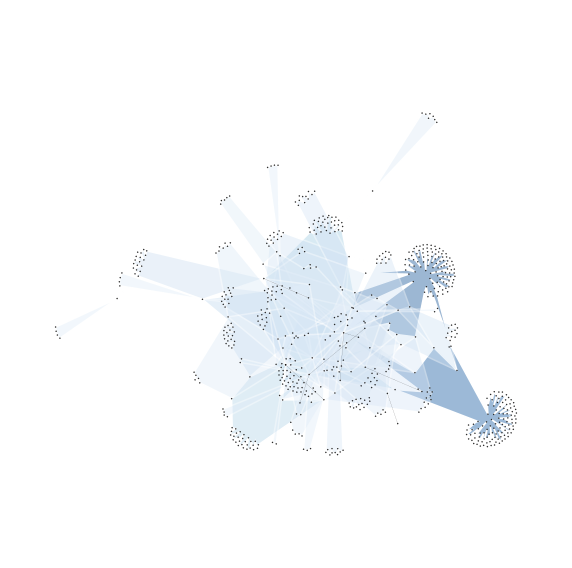

In [24]:
# hyperedges = [[1, 2, 8,9], [3,5,4], [4, 5, 6, 7]]
hyperedges=[dict_hyperedges[k] for k in dict_hyperedges.keys()]
hyperedges=hyperedges[0:60]
H = xgi.Hypergraph(hyperedges)
H = H.cleanup(
     singletons=False, isolates=False, relabel=True, in_place=False
)
fig, ax = plt.subplots(figsize=(10, 10))
xgi.draw(H,node_size=.5,dyad_lw=.1,node_fc=H.nodes.degree);



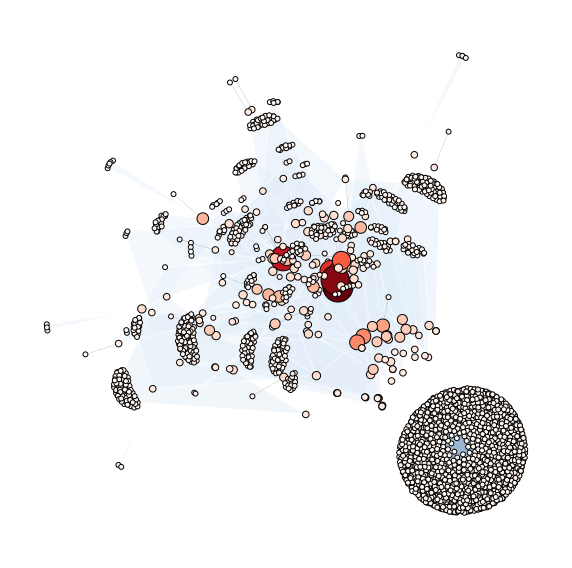

In [25]:
# hyperedges = [[1, 2, 8,9], [3,5,4], [4, 5, 6, 7]]
hyperedges=[dict_hyperedges[k] for k in dict_hyperedges.keys()]
hyperedges=hyperedges[400:500]
H = xgi.Hypergraph(hyperedges)
H = H.cleanup(
     singletons=False, isolates=False, relabel=True, in_place=False
)
fig, ax = plt.subplots(figsize=(10, 10))
# xgi.draw(H,node_size=.5,dyad_lw=.1,node_fc=H.nodes.degree);


xgi.draw(H, node_size=H.nodes.degree,dyad_lw=.1,node_fc=H.nodes.degree);


In [278]:
len(dict_hyperedges.keys())

24170

## keyword extraction


In [305]:
# !pip install yake
# !pip install nltk

In [304]:
import nltk
import yake 
from nltk.stem import PorterStemmer
nltk.download("punkt")


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Chowdhary\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.


True

In [331]:
kw_extractor = yake.KeywordExtractor()
data=list(df_com_climate['body'])
x=56000
text='\n'.join(data[x:x+500])

# Initialize Python porter stemmer
ps = PorterStemmer()
# text=' '.join([ps.stem(word) for word in text.split(' ')])

# keywords = kw_extractor.extract_keywords(text)

# for kw in keywords:
# 	print(kw)

language = "en"
max_ngram_size = 3
deduplication_threshold = 0.7
deduplication_algo = 'seqm'
windowSize = 2
numOfKeywords = 20

custom_kw_extractor = yake.KeywordExtractor(lan=language, n=max_ngram_size, dedupLim=deduplication_threshold, dedupFunc=deduplication_algo, windowsSize=windowSize, top=numOfKeywords, features=None)
keywords = custom_kw_extractor.extract_keywords(text)

for kw in keywords:
    print(kw)

('climate change', 0.00010912904804650436)
('climate', 0.0005213047725526127)
('fight spam bots', 0.0006101267413415634)
('change', 0.0008752259484359698)
('anthropogenic climate change', 0.0018381194035351279)
('spam bots', 0.0020502677122951523)
('people', 0.002525995028607795)
('fight spam', 0.0026893979019682293)
('global warming', 0.0028936219818619362)
('fight climate change', 0.0030446082991652497)
('climate change related', 0.003054536688948385)
('climate warming feedback', 0.0033117900366770223)
('bots by banning', 0.003563680405087951)
('Climate Change Communication', 0.0035639580143467186)
('world', 0.0036601710138018354)
('Mods', 0.0038829791775993904)
('global', 0.003929371328074082)
('Global Change', 0.0041232784864053615)
('years', 0.004540549535154735)
('article', 0.00493830655651269)


In [277]:
# for x in H.nodes.degree:
#     print(x)

## Visualizing topics 

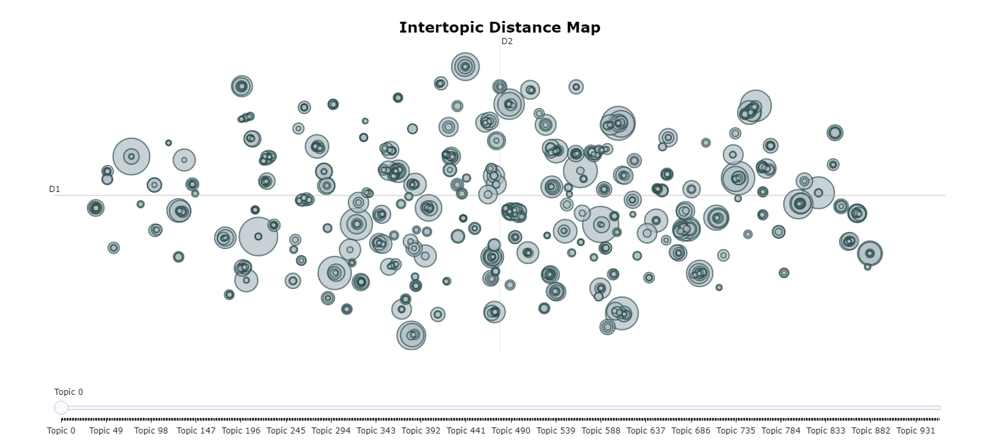

In [95]:

import plotly
topic_model.visualize_topics().show()


## reducing/ merging topics

In [67]:
topic_model.reduce_topics(df_sub_climate['title'],nr_topics=30)


AttributeError: 'BERTopic' object has no attribute 'topics'

In [207]:
topics= topic_model.topics_
df_topics=topic_model.get_document_info(df_sub_climate['title'])



In [74]:


# df_com_climate['created_utc_'] = pd.to_datetime(df_com_climate['created_utc'], unit='s')
df_topics=topic_model.get_document_info(df_sub_climate['title'])
df_topics
df_sub_climate['topic']=df_topics['Topic']
df_sub_climate['topic_name']=df_topics['Name']
df_sub_climate['probability']=df_topics['Probability']
df_sub_climate=df_sub_climate.sort_values(by=['topic','created_utc_'])
df_sub_climate_w_topics=df_sub_climate[['author', 'title', 
       'num_comments', 'num_crossposts', 'score', 'id',
        'upvote_ratio', 'created_utc_',
        'topic', 'topic_name', 'probability']]
df_sub_climate_w_topics=df_sub_climate_w_topics[df_sub_climate_w_topics['topic']!=-1]
df_sub_climate_w_topics=df_sub_climate_w_topics[df_sub_climate_w_topics['topic'].astype(str)!='nan']



In [78]:
df_sub_climate_w_topics.groupby(by='topic')['num_comments'].mean()
X=df_sub_climate_w_topics.groupby(by='topic')['num_comments'].count()
X
# np.sum(np.array(list(X))>25)

topic
0.0     5715
1.0       82
2.0       62
3.0       36
4.0       34
5.0       34
6.0       22
7.0       23
8.0       19
9.0       15
10.0       6
11.0      11
12.0       4
13.0       6
14.0       5
15.0       6
16.0       2
17.0       3
18.0       1
19.0       4
21.0       3
22.0       2
23.0       1
24.0       1
25.0       1
26.0       2
Name: num_comments, dtype: int64

## Hypergraph

In [208]:
# !pip install xgi==0.7.3


In [18]:
import xgi
hyperedges = [[1, 2, 8,9], [3,5,4], [4, 5, 6, 7]]
H = xgi.Hypergraph(hyperedges)
H.add_node(8)
H.add_edge([7, 8])
H.add_nodes_from([9, 10])
H.add_edges_from([[1, 10], [8, 9, 10]])


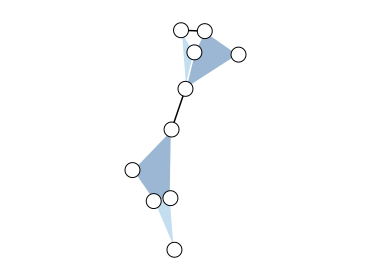

In [19]:
xgi.draw(H);

### random stuff

In [149]:
df_sub_climate.sort_values('num_comments',ascending=False)


,author,title,subreddit,selftext,created_utc,num_comments,num_crossposts,score,id,subreddit_subscribers,upvote_ratio,created_utc_,filter,num_posts_on_subreddit
1928985,cnbc_official,Bill Gates on why he’ll carry on using private...,climate,nan,1675773769,2815,7.0,12162,10w0v9z,155777.0,0.85,2023-02-07 12:42:49,False,87354
1966998,burtzev,Scientists deliver ‘final warning’ on climate ...,climate,nan,1679320725,1954,6.0,10827,11wjlno,157979.0,0.86,2023-03-20 13:58:45,False,87354
1950825,enkrstic,Greta Thunberg removed by cops in Norway durin...,climate,nan,1677669340,1113,2.0,2780,11f15g3,158008.0,0.83,2023-03-01 11:15:40,False,87354
1481675,treebeard280,"To celebrate my cake day, I will plant a tree ...",climate,I will see how many comments this post gets af...,1635923338,1013,0.0,458,qlp0tr,126514.0,0.98,2021-11-03 07:08:58,False,87354
1637752,oldgrowthforests,Eat. Less. Meat,climate,nan,1649899606,857,2.0,0,u35s23,122056.0,0.46,2022-04-14 01:26:46,False,87354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
393123,ecointernetnewsfeed,Fracking Study Finds Low Birth Weights Near Na...,climate,nan,1513202712,0,0.0,6,7jmscc,NaN,NaN,2017-12-13 22:05:12,False,87354
393137,getrealitychecks,Q: Can growth be decoupled from emissions? A: ...,climate,nan,1513177342,0,0.0,1,7jjsh6,NaN,NaN,2017-12-13 15:02:22,False,87354
393180,avogadros_number,The Dirty Secret of the Global Plan to Avert C...,climate,nan,1513184070,0,0.0,5,7jkjz9,NaN,NaN,2017-12-13 16:54:30,False,87354
393184,avogadros_number,Arctic Sea Ice Hits Yet Another Brutal Milestone,climate,nan,1513184340,0,0.0,10,7jkl3i,NaN,NaN,2017-12-13 16:59:00,False,87354


,author,body,subreddit,created_utc,controversiality,score,link_id,parent_id,commentintop100subreddit,created_utc_


In [153]:
df_com_climate['link_id_trimmed']=df_com_climate['link_id'].str.replace('t3_','')

In [155]:
df_com_climate[df_com_climate['link_id_trimmed']=='10w0v9z']

,author,body,subreddit,created_utc,controversiality,score,link_id,parent_id,commentintop100subreddit,created_utc_,link_id_trimmed
14602735,zmitic,&gt;How are carbon capture companies a scam?\n...,climate,1675778703,0,4,t3_10w0v9z,t1_j7kfi1a,True,2023-02-07 14:05:03,10w0v9z
14602745,grumpy-senior,word salad much ?,climate,1675778743,0,2,t3_10w0v9z,t1_j7khw1n,True,2023-02-07 14:05:43,10w0v9z
14602748,cryptographerok6522,It’s a necessary evil so that he can do the wo...,climate,1675778768,0,22,t3_10w0v9z,t3_10w0v9z,True,2023-02-07 14:06:08,10w0v9z
14602915,cnbc_official,Bill Gates does not agree that using a private...,climate,1675773793,0,142,t3_10w0v9z,t3_10w0v9z,True,2023-02-07 12:43:13,10w0v9z
14602916,automoderator,[BP popularized the concept of a carbon footpr...,climate,1675773794,0,31,t3_10w0v9z,t1_j7kcd1b,True,2023-02-07 12:43:14,10w0v9z
...,...,...,...,...,...,...,...,...,...,...,...
14881422,flaky-ad-8235,“Carbon offsets”. Biggest climate scam ever ...,climate,1678795526,0,1,t3_10w0v9z,t3_10w0v9z,True,2023-03-14 12:05:26,10w0v9z
14901661,scorpiolaw,Honestly just because he isn't 100% shining b...,climate,1679024667,0,1,t3_10w0v9z,t1_j7kcd1b,True,2023-03-17 03:44:27,10w0v9z
14930512,rweber130,Bill Gates says he's not part of the problem b...,climate,1679361304,0,1,t3_10w0v9z,t1_j7kcd1b,True,2023-03-21 01:15:04,10w0v9z
14944876,sarcofaygo,You don't have to be saintly to use zoom inste...,climate,1679504427,0,1,t3_10w0v9z,t1_j7kpnzp,True,2023-03-22 17:00:27,10w0v9z


## debate a vegan subreddit

In [11]:
df_sub_debateavegan=df_submissions_filtered[df_submissions_filtered['subreddit']=='debateavegan']
df_com_debateavegan=df_comments_filtered[df_comments_filtered['subreddit']=='debateavegan']

In [25]:
# df_com_debateavegan.groupby(by='author').count()

In [9]:
from bertopic import BERTopic
# df_sub_debateavegan['selftext']=df_sub_debateavegan['selftext'].astype(str)
np.mean(df_sub_debateavegan['selftext']!='nan')
### time it 
import time
T0=time.time();
topic_model = BERTopic()
topics, probs = topic_model.fit_transform(df_sub_debateavegan['title'])
T1=time.time();
print('Time elasped= ', (T1-T0)/3600 )
freq = topic_model.get_topic_info()
freq.head(20)

Time elasped=  0.032871200574768916


,Topic,Count,Name,Representation,Representative_Docs
0,-1,3750,-1_vegans_the_to_and,"[vegans, the, to, and, vegan, of, veganism, yo...","[Are you vegan?, Would you consider someone ve..."
1,0,443,0_meat_eating_eat_eater,"[meat, eating, eat, eater, eaters, wrong, indu...","[Why I eat meat, Why I eat Meat, Meat]"
2,1,368,1_moral_ethical_ethics_veganism,"[moral, ethical, ethics, veganism, morality, m...","[Veganism is not a moral obligation., The Vega..."
3,2,323,2_killing_kill_animals_it,"[killing, kill, animals, it, an, eat, animal, ...","[Why is it wrong to KILL an animal, Animals Ki..."
4,3,164,3_carnivore_omnivores_omnivore_carnivores,"[carnivore, omnivores, omnivore, carnivores, c...","[Humans are omnivores., Many omnivores and car..."
5,4,159,4_pets_cats_pet_dogs,"[pets, cats, pet, dogs, cat, feed, dog, keepin...","[vegan pets, Vegan pets, Vegan pets]"
6,5,155,5_pets_cat_pet_dogs,"[pets, cat, pet, dogs, cats, service, dog, eut...",[It is unethical to keep a cat as a pet and fe...
7,6,152,6_deleted_user_by_removed,"[deleted, user, by, removed, reddit, , , , , ]","[[deleted by user], [deleted by user], [delete..."
8,7,135,7_against_argument_arguments_best,"[against, argument, arguments, best, veganism,...","[Arguments Against Veganism, Argument against ..."
9,8,127,8_products_companies_nonvegan_vegan,"[products, companies, nonvegan, vegan, options...",[Discussion on buying vegan products from non-...


In [12]:
from bertopic import BERTopic
df_sub_climate['selftext']=df_sub_climate['selftext'].astype(str)
np.mean(df_sub_climate['selftext']!='nan')
### time it 
# topic_model = BERTopic()
# topics, probs = topic_model.fit_transform(df_sub_climate['title'])
freq = topic_model.get_topic_info()
freq.head(20)

NameError: name 'df_sub_climate' is not defined

In [10]:
print('Time elasped= ', (T1-T0)/60 )


Time elasped=  1.9722720344861349


In [42]:
df_com_climate

NameError: name 'df_com_climate' is not defined